![CFAR windows](figures/juliaEO2023/JuliaEO_banner.png "Julia EO 2023 Banner")


In this hands-on workshop, we will introduce the [SARprocessing.jl](https://github.com/AIRCentre/SARProcessing.jl) package and see how it can be used to work with Sentinel-1 SAR images. 

This hand-on is somewhat an extention of the [Introduction of SAR, presented at JuliaEO 2023](www.link_to_pres.com). However, we assume no privious knowlegde of SAR data in this notebook.


## Table Of Contents
-  [Include and Introduce SARProcessing.jl](#Include) 
-  [Load and show Image](#show_image)
-  [Speckle Reduction](#speckle)
-  [Object Detection in SAR images](#CFAR)
-  [Interferometry](#insar)



# SARProcessing.jl

 <a class="anchor" id="Include"></a>

Firstly, loading the packaged that we will need.

In [53]:
using SARProcessing;
using Pkg;
Pkg.add("Plots"); #not included in SARProcessing
#Pkg.add("SARProcessing"); #not included in SARProcessing
using Plots;

   Resolving package versions...
  No Changes to `~/Documents/coding/SARProcessing.jl/Project.toml`
  No Changes to `~/Documents/coding/SARProcessing.jl/Manifest.toml`




Skal vi have en lille gennemgang af SARproccessing. 

# Load and Show image
 <a class="anchor" id="show_image"></a>

Below we see an example of a SAR image.

#### Observations:

* Higher intensity in the left side of  the image.

* High and low intensity patterns in the ocean.

* Land has higher intensity than ocean

* High intensity peaks mid ocean

![CFAR windows](figures/juliaEO2023/s1a-iw-grd-vv-20220713t210909-20220713t210935-044087-054337-001.png "GRD image s1a-iw-grd-vv-20220713t210909-20220713t210935-044087-054337-001")



Generally, SAR images are large. SLC images are approx 7.3 GB whereas GRD images are approx. 1.75 GB. We are therefore using smaller subsets for this workshop. Full images can be downloaded from https://search.asf.alaska.edu/#/




-----------


### Loading Subsets

.tiff images can be loaded using the load_tiff function in the SARProcessing module. 

In this section, we will load XXX images, all acquired from the Sentinel-1 C-band SAR satellite. 
- Single Look Complex subset acquired near the Azores
- Something for Interferometry?



In [56]:
using Pkg
Pkg.add("JLD")
using JLD

   Resolving package versions...


  No Changes to `~/Documents/coding/SARProcessing.jl/Project.toml`
  No Changes to `~/Documents/coding/SARProcessing.jl/Manifest.toml`


In [54]:
slcSubsetPath = "../test/testData/s1a-iw3-slc-vv_subset_hight9800_10400_width11000_11000.tiff";
slc_image = abs.(SARProcessing.load_tiff(slcSubsetPath));
grd_image_hom2 = load("grd_image_hom.jld")["grd_image_hom"];
grd_image2 = load("grd_image.jld")["grd_image"];

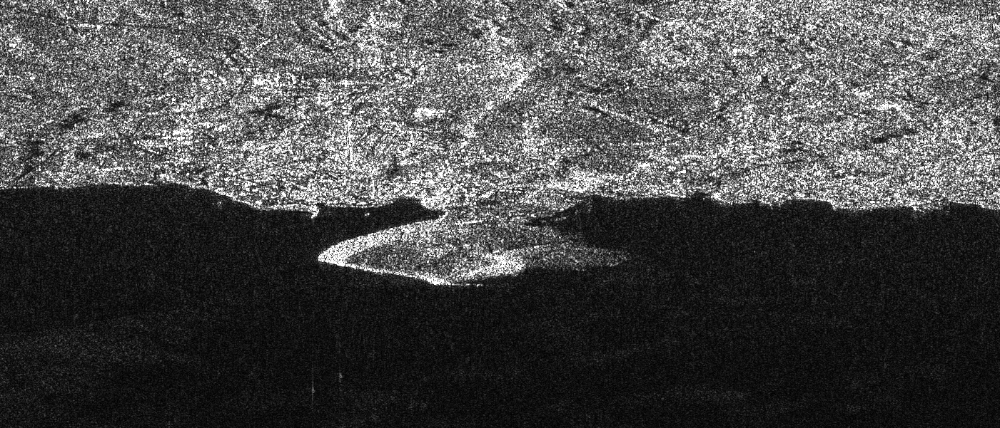

In [4]:
SARProcessing.sar2gray(slc_image, p_quantile = 0.95)

The SLC image above is acquired fromt the azores

![CFAR windows](figures/where_azores.png "azores region")



* point scatters on the ocean
* somewhat homogoneous sea state
* high intensity in the city

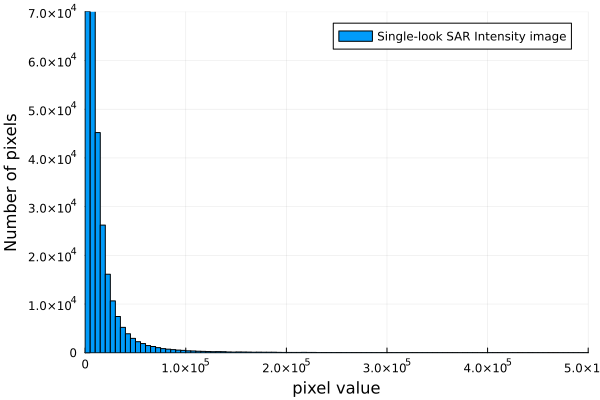

In [5]:
h = histogram(vcat(slc_image.^2...),label="Single-look SAR Intensity image")
ylims!((0,70000))
xlims!((0,500000))
xlabel!("pixel value")
ylabel!("Number of pixels")

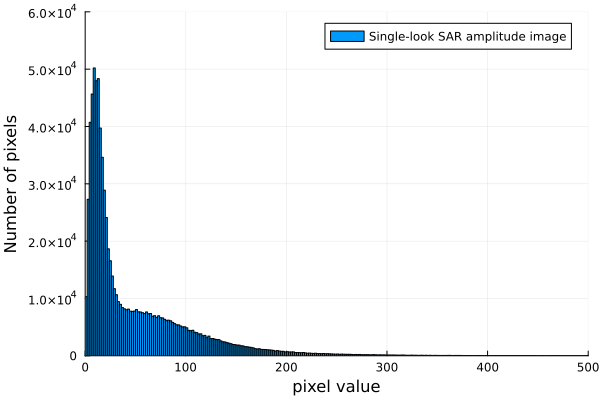

In [38]:
h = histogram(vcat(slc_image...),label="Single-look SAR amplitude image")
ylims!((0,60000))
xlims!((0,500))
xlabel!("pixel value")
ylabel!("Number of pixels")

### GRD Image

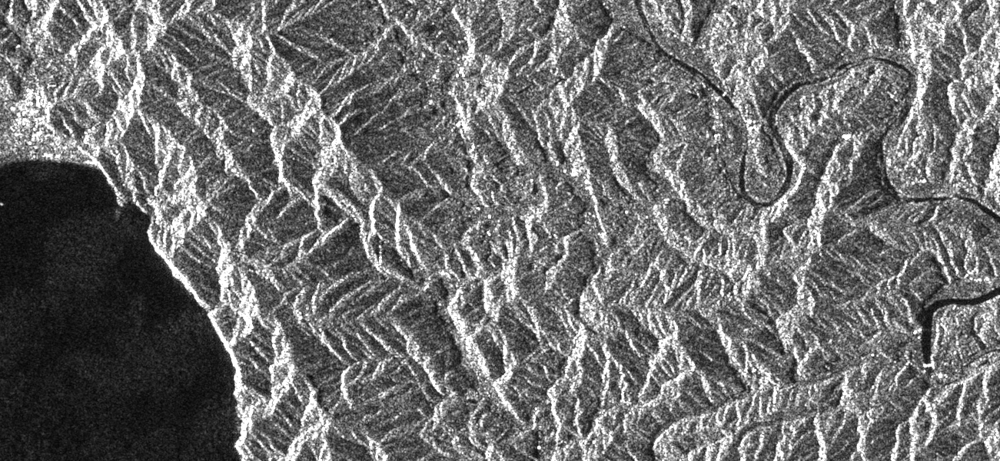

In [6]:
SARProcessing.sar2gray(grd_image, p_quantile = 0.95)

* Relativly high and low patched on the water, with some regions looking somewhat homogeneous.
* Lake has low reflectivity
* Moutain structure

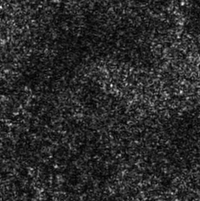

In [7]:
SARProcessing.sar2gray(grd_image[400:600,1:200].^2, p_quantile = 0.99999)

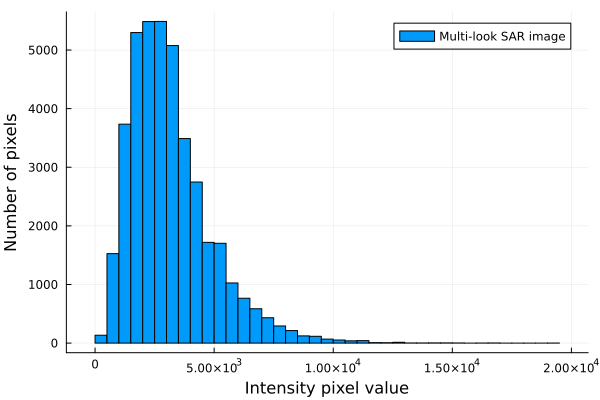

In [27]:
h = histogram(vcat(grd_image[400:600,1:200].^2...),label="Multi-look SAR image",bins=70)

xlabel!("Intensity pixel value")
ylabel!("Number of pixels")



In [ ]:
h = histogram(vcat(grd_image_hom.^2...),label="Multi-look SAR image")

xlabel!("Intensity pixel value")
ylabel!("Number of pixels")

---------------

* We have now seen how the SARProcessing.jl module can be used to load SAR images. 
* We have looked at SAR images
* Looked at the histograms 

---------------

# Speckle
 <a class="anchor" id="speckle"></a>

The Sentinel-1 satellite has a spatial pixel resolution of approx 3.1 m x 21.7 m. However, in each pixel, there are very many individual scatters. Each of these individual scatters contributate with their own individual amplitude and phase

$ A exp(j \phi)  = \sum_i A_i exp(j \phi_i) $

where $A$ is the Amplitude of the signal and $\phi$ the phase.



![CFAR windows](figures/juliaEO2023/speckle.png "CFAR windows" )

The wavelength of the SAR is much smaller than the resolution cell and the distance between the individual scatters and the phase therefore varies greatly. In fact:
- The phase varies approximatly uniform in [$-\pi : \pi$]
- The phase is independant of A
- The Amplitude is uncorrelated




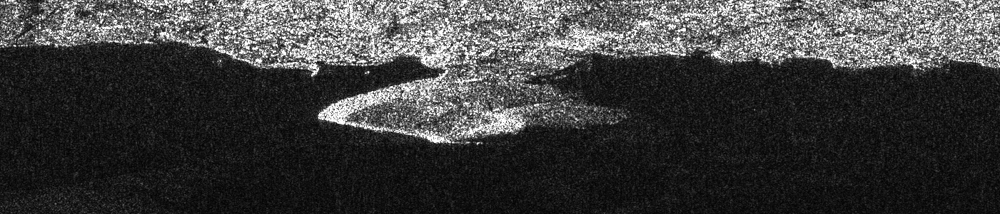

In [9]:
SARProcessing.sar2gray(slc_image[200:500,:], p_quantile = 0.95)

### Speckle Reduction



The objective of speckle reduction is to reduce the variance of the pixels such that a better estiamte of the intensity is found. The trade-off is a poorer spatial resolution. There exsits very many speckle filters that all tries to reduce this black-white granularity. The following introduces:
- Mean filter
- Lee filter

The mean filter is a simple filter that simply assign the mean value of a region to a center pixel.

The Lee filter is an adaptive filter, that varies the degree of speckle filtering depending on the homogenity of the region. For very homogenous regions, it resembles the Mean filter. However, close to, e.g., edges or in very inhomogenous region the speckle filtering reduces.

#### Homogenous region

ENL of region: 4.73


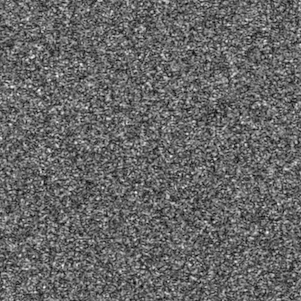

In [10]:
println("ENL of region: ",round(SARProcessing.equivalent_number_of_looks_intensity(grd_image_hom.^2); digits = 2))
SARProcessing.sar2gray(grd_image_hom, p_quantile = 0.99999)

In [11]:
hom_descpek_mean_9 = SARProcessing.speckle_mean_filter(grd_image_hom.^2,[9,9]);
hom_descpek_lee_9 = SARProcessing.speckle_lee_filter(grd_image_hom.^2,[9,9]);

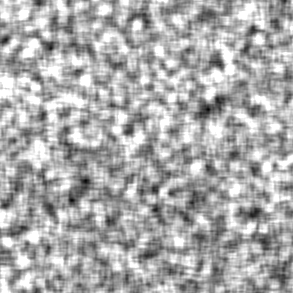

In [12]:
SARProcessing.sar2gray(hom_descpek_mean_9, p_quantile = 0.95)


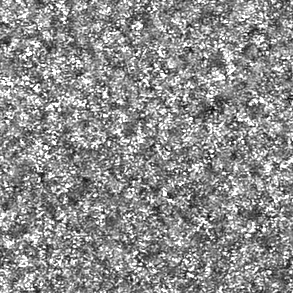

In [13]:
SARProcessing.sar2gray(hom_descpek_lee_9, p_quantile = 0.95)


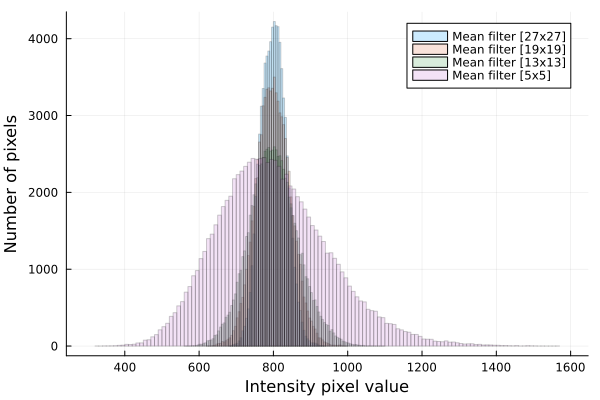

In [14]:
histogram(vcat(SARProcessing.speckle_mean_filter(grd_image_hom.^2,[27,27])...),label="Mean filter [27x27]", alpha = 0.2)
histogram!(vcat(SARProcessing.speckle_mean_filter(grd_image_hom.^2,[19,19])...),label="Mean filter [19x19]", alpha = 0.2)
histogram!(vcat(SARProcessing.speckle_mean_filter(grd_image_hom.^2,[13,13])...),label="Mean filter [13x13]", alpha = 0.2)
histogram!(vcat(SARProcessing.speckle_mean_filter(grd_image_hom.^2,[5,5])...),label="Mean filter [5x5]", alpha = 0.2)

xlabel!("Intensity pixel value")
ylabel!("Number of pixels")

#### Inhomogenous region

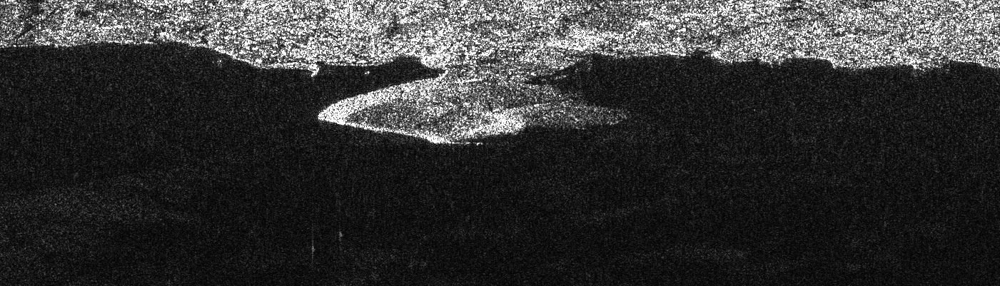

In [15]:
SARProcessing.sar2gray(slc_image[200:600,:], p_quantile = 0.96)

In [48]:
descpek_mean_9 = SARProcessing.speckle_mean_filter(slc_image,[11,11]);
descpek_lee_9 = SARProcessing.speckle_lee_filter(slc_image,[11,11]);

#### Mean filter

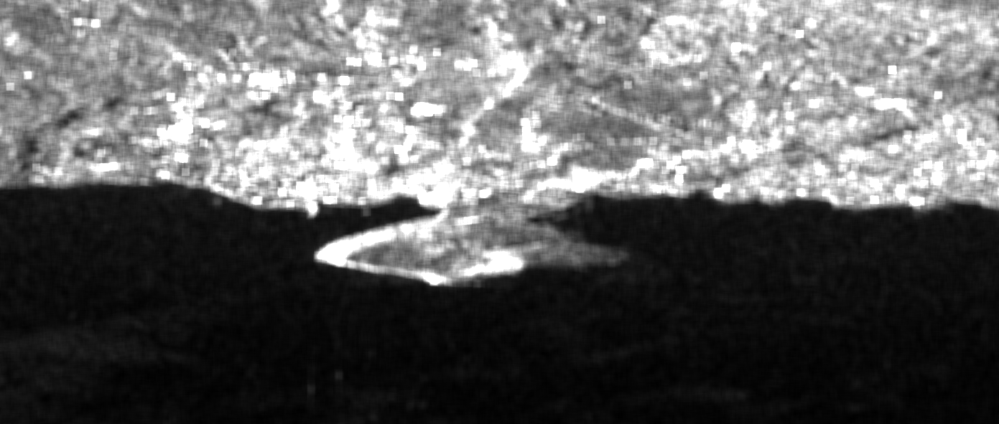

In [49]:
SARProcessing.sar2gray(descpek_mean_9, p_quantile = 0.95)

#### Lee filter

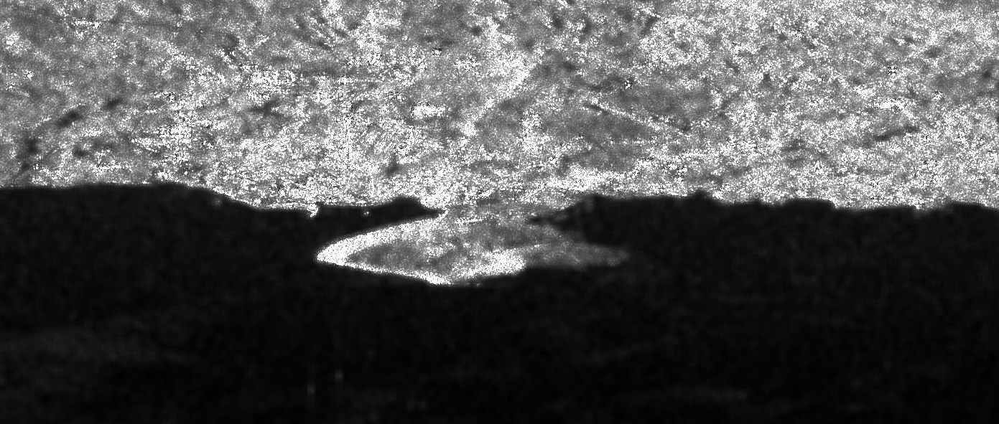

In [50]:
SARProcessing.sar2gray(descpek_lee_9, p_quantile = 0.95)

# Object detection
 <a class="anchor" id="cfar"></a>


Object detection is used in many fiels of earth observation in both the land and maritime enviroment. For the maritime enviroment, it is used in great extent for, e.g., iceberg detection or ship detection. Often, object detection is used as a priliminary analysis whereafter the detected objects are classified as belonging to different classes. 

In the following section we will

- Use CA-CFAR and CP-CFAR object detectors to find objects in an image
- Extract the locations of the objects
- Extract a subset of the objects

### CFAR
 <a class="anchor" id="CFAR"></a>

Generally, adaptive object detectors based on thresholds are made to find pixel values that are brighter than the surrounding pixels. An adaptive threshold is set based on the local statistics. If a given pixel has a higher value than the adaptive threshold, it is an object. One such threshold is the Constant False Alarm Rate (CFAR), applicable when one is looking for a specific intensity structure. For CFAR, the statistics is computed from a background box. 



A simple CFAR is based on the histogram of the values within a kernel. A threshold value is then found as the X’th percentile value of the pixels within the kernel. Setting the CFAR at, e.g., the 0.99 percentile will result in a threshold that can discern very high values from low values, thus finding objects. The percentile value will stay constant for all regions defined by the moving kernel, but the threshold value itself will change.


![CFAR windows](figures/cfar_windows.png "CFAR windows")


### CA-CFAR
 <a class="anchor" id="ca_cfar"></a>


A more advanced two-parameter CFAR utilises two parameters for finding objects and is explained in (Crisp, 2004). A so-called adaptive threshold algorithm using a background, a guard, and a target window is used. All three windows are applied on the entire image, one shifting pixel at a time. The Background window is used to calculate the statistics of the surrounding homogeneous area.

The threshold is set by ensuring that the probability of false alarms is constant, hence Probability of False Alarms (PFA). The threshold is chosen such that the percentage of background pixel values above the threshold is constant. We will therefore get a constant number of false alarms per unit area of the image. Hence the name, Constant False Alarm Rate (CFAR). Here, the background area samples are used to estimate the parameters instead of using the entire image.  
CFAR follows: 

$ x_t > T,$  
where $x_t$ is the pixel in the target box and T the threshold. If we assume a gaussian distribution for the CFAR detector,  we have:

$ x_t > \mu_b + \sigma_b t,$ 

where $t$ is found from the PFA. Therfore the name two-paramter CFAR. If images have a constant normalized variance, then $\sigma_b$ is proportional to $\mu_b $ and we can therfore apply it to target cells of differet areas, called Cell-Averaging CFAR (CA-CFAR) with 

$ t_{CA} = t/\sqrt(N)$ 

where $N$ is the number of pixels in the target window since averaging N samples from a Gaussian distribution with $\mu$ and $\sigma$ produces another Gaussain distribution with $\mu$ and standard deviation $\sigma / \sqrt(N)$

The size of both the guard and background(clutter) windows must therefore be defined. Likewise should the probability for false alarms (PFA) 

In [19]:
background_window = 41; 
guard_window = 31;
probability_for_alarms = 10^(-12);
target_window=3;

In [20]:
image_ca_cfar = SARProcessing.cell_averaging_constant_false_alarm_rate(slc_image.^2,background_window,guard_window,target_window,probability_for_alarms);

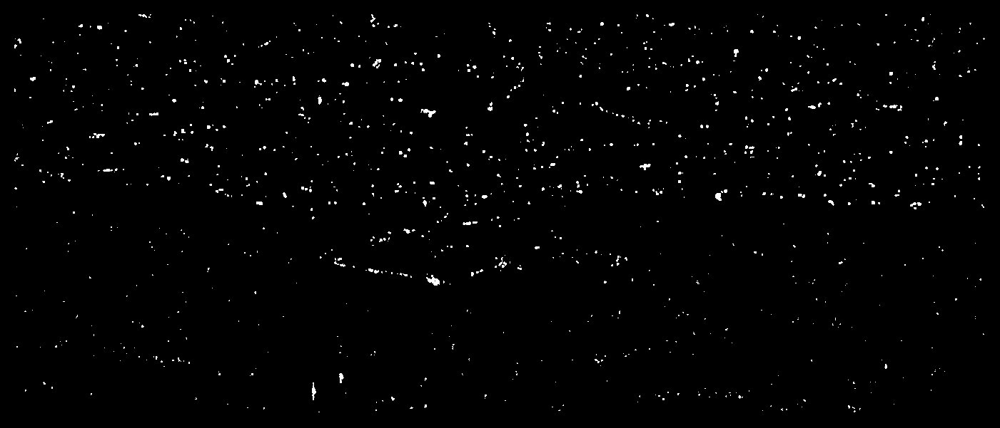

In [21]:
SARProcessing.sar2gray(image_ca_cfar, p_quantile = 0.95)

### CP-CFAR
<a class="anchor" id="cp_cfar"></a>

The CP-CFAR, described in *SAR Target CFAR Detection Via GPU Parallel Operation, Zongyong Cui et al, 2018,* utilizes morphological operations to reduce the number of false alarms and increase computation speed.

![CP-CFAR](figures/cp_cfar.png "CP-CFAR")


In [22]:
image_cp_cfar = SARProcessing.constant_false_alarm_rate_with_convolution_and_pooling(slc_image.^2,background_window ÷ 2,guard_window ÷ 2,probability_for_alarms);

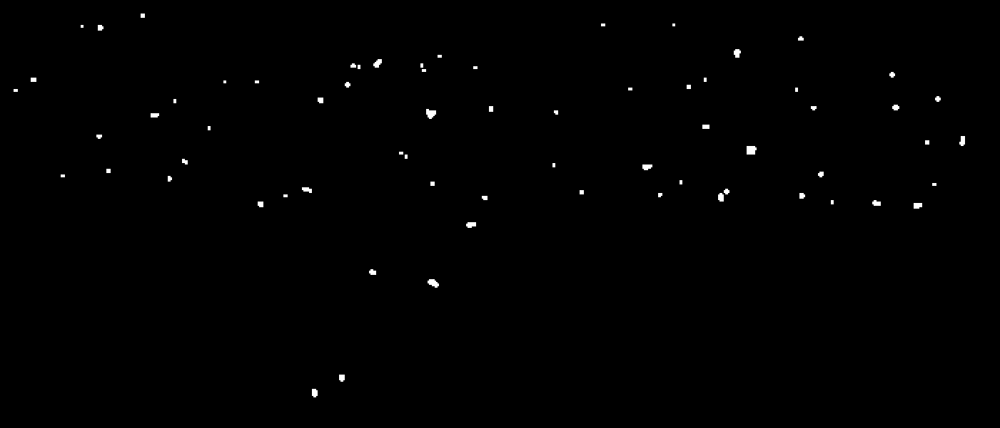

In [23]:
SARProcessing.sar2gray(image_cp_cfar, p_quantile = 0.95)

### Plotting objects in image
<a class="anchor" id="show_objects"></a>

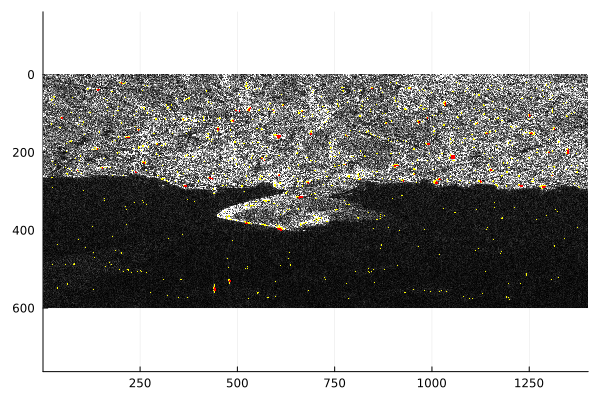

In [24]:
heatmap(SARProcessing.sar2gray(slc_image, p_quantile = 0.95),legend = :none)
heatmap!(SARProcessing.mask_array_nan(convert.(Float64,image_ca_cfar)),color=:yellow,legend = :none)
heatmap!(SARProcessing.mask_array_nan(convert.(Float64,image_cp_cfar)),color=:red,legend = :none)

### Location of objects
<a class="anchor" id="Location_of_subsets"></a>

In [25]:
#image_cp_cfar = SARProcessing.binarize_array(image_cp_cfar);
#image_ca_cfar = SARProcessing.binarize_array(image_ca_cfar);

In [26]:
index_cp = SARProcessing.object_locations(convert.(Float64,image_cp_cfar));
index_ca = SARProcessing.object_locations(convert.(Float64,image_ca_cfar));

Illustrating the locations of the objects using CA-CFAR and CP-CFAR respectivly. 

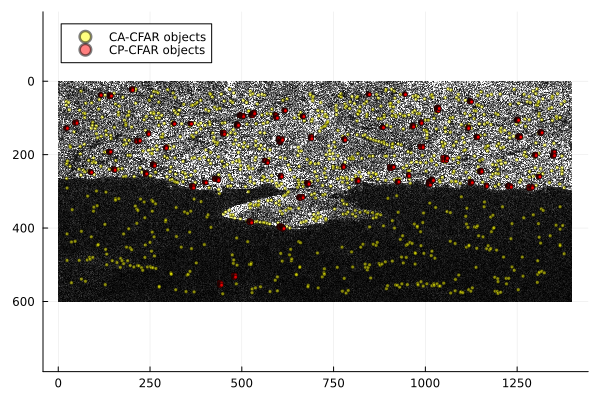

In [31]:
heatmap(SARProcessing.sar2gray(slc_image, p_quantile = 0.95))
plot!(convert.(Float64,last.(index_ca)),convert.(Float64,first.(index_ca)), seriestype=:scatter, label="CA-CFAR objects", mc=:yellow, ms=2, ma=0.5)
plot!(convert.(Float64,last.(index_cp)),convert.(Float64,first.(index_cp)), seriestype=:scatter, label="CP-CFAR objects", mc=:red, ms=2, ma=0.5)


### getting subset of object

In [43]:
index = findall(first.(index_cp) .== maximum(first.(index_cp)) );
coordinates = index_cp[index][1]
subset = SARProcessing.get_subset(slc_image,coordinates ,[45,45]);

coordinates2 = index_cp[50]
subset2 = SARProcessing.get_subset(slc_image,coordinates2 ,[45,45]);

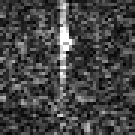

In [44]:
SARProcessing.sar2gray(subset[:,:,1], p_quantile = 0.99)


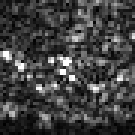

In [45]:
SARProcessing.sar2gray(subset2[:,:,1], p_quantile = 0.99)

# Now what





* Change paramters of Speckle filters and object detectors.
* What if we perform speckle filtering before obejct detecting?
* Implement your own filter. Instead of mean, implement, e.g., a median filter, Frost filter.
* Try another image